<a href="https://colab.research.google.com/github/gadididi/DL--BIU---2021/blob/main/monet_to_photo_gadi_nerya.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Step 1. Import Libraries

In [1]:
import numpy as np

import torchvision.transforms as transforms
from torchvision.utils import make_grid

from torch.utils.data import DataLoader
from torchvision import datasets
from torch.autograd import Variable

import torch.nn as nn
import torch.nn.functional as F
import torch

In [2]:
#clone the project and the data set (images from kaggle)
!git clone  https://github.com/gadididi/DL--BIU---2021.git
!mkdir -p ./monet_jpg
!mkdir -p ./photo_jpg
!mv ./DL--BIU---2021/monet_jpg.zip ./monet_jpg
!mv ./DL--BIU---2021/data/*.zip ./photo_jpg

!ls ./monet_jpg
!ls ./photo_jpg

Cloning into 'DL--BIU---2021'...
remote: Enumerating objects: 36, done.
remote: Counting objects: 100% (36/36), done.
remote: Compressing objects: 100% (32/32), done.
remote: Total 36 (delta 12), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (36/36), done.
monet_jpg.zip
photo_jpg1.zip	photo_jpg2.zip	photo_jpg3.zip	photo_jpg4.zip	photo_jpg5.zip


In [3]:
# monet paint unzip
!unzip  ./monet_jpg/*.zip -d ./



Archive:  ./monet_jpg/monet_jpg.zip
  inflating: ./monet_jpg/000c1e3bff.jpg  
  inflating: ./monet_jpg/011835cfbf.jpg  
  inflating: ./monet_jpg/0260d15306.jpg  
  inflating: ./monet_jpg/049e293b93.jpg  
  inflating: ./monet_jpg/05144e306f.jpg  
  inflating: ./monet_jpg/052a77c020.jpg  
  inflating: ./monet_jpg/058f878b7c.jpg  
  inflating: ./monet_jpg/05b493ff42.jpg  
  inflating: ./monet_jpg/064487d630.jpg  
  inflating: ./monet_jpg/066fe4cbaa.jpg  
  inflating: ./monet_jpg/07fcaee35f.jpg  
  inflating: ./monet_jpg/09b76b6471.jpg  
  inflating: ./monet_jpg/0a5075d42a.jpg  
  inflating: ./monet_jpg/0bd913dbc7.jpg  
  inflating: ./monet_jpg/0e3b3292da.jpg  
  inflating: ./monet_jpg/106757e5d8.jpg  
  inflating: ./monet_jpg/1078363ff0.jpg  
  inflating: ./monet_jpg/10c555c1b1.jpg  
  inflating: ./monet_jpg/118da0690c.jpg  
  inflating: ./monet_jpg/11ab570c5e.jpg  
  inflating: ./monet_jpg/11be65b3e9.jpg  
  inflating: ./monet_jpg/133b42e498.jpg  
  inflating: ./monet_jpg/14162de938.jpg 

In [4]:
# photo unzip
!unzip  ./photo_jpg/photo_jpg1.zip -d ./photo_jpg
!unzip  ./photo_jpg/photo_jpg2.zip -d ./photo_jpg
!unzip  ./photo_jpg/photo_jpg3.zip -d ./photo_jpg
!unzip  ./photo_jpg/photo_jpg4.zip -d ./photo_jpg
!unzip  ./photo_jpg/photo_jpg5.zip -d ./photo_jpg

Streaming output truncated to the last 5000 lines.
  inflating: ./photo_jpg/37c5732454.jpg  
  inflating: ./photo_jpg/37cc9acfc2.jpg  
  inflating: ./photo_jpg/37cfa76bf2.jpg  
  inflating: ./photo_jpg/37d0b619d1.jpg  
  inflating: ./photo_jpg/37d3e79b71.jpg  
  inflating: ./photo_jpg/37df208f9f.jpg  
  inflating: ./photo_jpg/37eb07f626.jpg  
  inflating: ./photo_jpg/37f738e7bc.jpg  
  inflating: ./photo_jpg/37fba790de.jpg  
  inflating: ./photo_jpg/38bb0ec345.jpg  
  inflating: ./photo_jpg/38c88ad59d.jpg  
  inflating: ./photo_jpg/38c6532fe1.jpg  
  inflating: ./photo_jpg/38cb53af79.jpg  
  inflating: ./photo_jpg/38d0de69d8.jpg  
  inflating: ./photo_jpg/38d71d4dfe.jpg  
  inflating: ./photo_jpg/38d00950b6.jpg  
  inflating: ./photo_jpg/38d5379f18.jpg  
  inflating: ./photo_jpg/38d9042083.jpg  
  inflating: ./photo_jpg/38deab6c01.jpg  
  inflating: ./photo_jpg/38dfbc95b7.jpg  
  inflating: ./photo_jpg/38ebf8fc82.jpg  
  inflating: ./photo_jpg/38f185baa6.jpg  
  inflating: ./photo_jpg/

In [5]:
!rm -r ./monet_jpg/*.zip
!rm -r ./photo_jpg/*.zip

### Step 2. Initial Setting

In [6]:
n_cpu = 2 # number of cpu threads to use during batch generation

In [7]:
# data (path)
root = '.'

# data (img)
img_height = 256
img_width = 256
channels = 3

# training
epoch = 0 # epoch to start training from
n_epochs = 30 # number of epochs of training
batch_size = 1 # size of the batches
lr = 0.0002 # adam : learning rate
b1 = 0.5 # adam : decay of first order momentum of gradient
b2 = 0.999 # adam : decay of first order momentum of gradient
decay_epoch = 3 # suggested default : 100 (suggested 'n_epochs' is 200)
                 # epoch from which to start lr decay


### Step 3. Define Generator

In [8]:
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()
        
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1), # Pads the input tensor using the reflection of the input boundary
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features), 
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features)
        )

    def forward(self, x):
        return x + self.block(x)


class GeneratorResNet(nn.Module):
    def __init__(self, input_shape, num_residual_block):
        super(GeneratorResNet, self).__init__()
        
        channels = input_shape[0]
        
        # Initial Convolution Block
        out_features = 64
        model = [
            nn.ReflectionPad2d(channels),
            nn.Conv2d(channels, out_features, 7),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(inplace=True)
        ]
        in_features = out_features
        
        # Downsampling
        for _ in range(2):
            out_features *= 2
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features
        
        # Residual blocks
        for _ in range(num_residual_block):
            model += [ResidualBlock(out_features)]
            
        # Upsampling
        for _ in range(2):
            out_features //= 2
            model += [
                nn.Upsample(scale_factor=2), # --> width*2, heigh*2
                nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features
            
        # Output Layer
        model += [nn.ReflectionPad2d(channels),
                  nn.Conv2d(out_features, channels, 7),
                  nn.Tanh()
                 ]
        
        # Unpacking
        self.model = nn.Sequential(*model) 
        
    def forward(self, x):
        return self.model(x)

### Step 4. Define Discriminator

In [9]:
class Discriminator(nn.Module):
    def __init__(self, input_shape):
        super(Discriminator, self).__init__()
        
        channels, height, width = input_shape
        
        # Calculate output shape of image discriminator (PatchGAN)
        self.output_shape = (1, height//2**4, width//2**4)
        
        def discriminator_block(in_filters, out_filters, normalize=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers
        
        self.model = nn.Sequential(
            *discriminator_block(channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128,256),
            *discriminator_block(256,512),
            nn.ZeroPad2d((1,0,1,0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )
        
    def forward(self, img):
        return self.model(img)

In [10]:
criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

### Step 6. Initialize Generator and Discriminator

In [11]:
input_shape = (channels, img_height, img_width) # (3,256,256)
n_residual_blocks = 9 # suggested default, number of residual blocks in generator

Generator_monet_to_photo = GeneratorResNet(input_shape, n_residual_blocks)
Generator_photo_to_monet = GeneratorResNet(input_shape, n_residual_blocks)
Discriminator_monet = Discriminator(input_shape)
Discriminator_photo = Discriminator(input_shape)

### Step 7. GPU Setting

In [12]:
cuda = torch.cuda.is_available()

if cuda:
    Generator_monet_to_photo = Generator_monet_to_photo.cuda()
    Generator_photo_to_monet = Generator_photo_to_monet.cuda()
    Discriminator_monet = Discriminator_monet.cuda()
    Discriminator_photo = Discriminator_photo.cuda()
    
    criterion_GAN.cuda()
    criterion_cycle.cuda()
    criterion_identity.cuda()

### Step 8. Weight Setting

In [13]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02) # reset Conv2d's weight(tensor) with Gaussian Distribution
        if hasattr(m, 'bias') and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0) # reset Conv2d's bias(tensor) with Constant(0)
        elif classname.find('BatchNorm2d') != -1:
            torch.nn.init.normal_(m.weight.data, 1.0, 0.02) # reset BatchNorm2d's weight(tensor) with Gaussian Distribution
            torch.nn.init.constant_(m.bias.data, 0.0) # reset BatchNorm2d's bias(tensor) with Constant(0)

In [14]:
Generator_monet_to_photo.apply(weights_init_normal)
Generator_photo_to_monet.apply(weights_init_normal)
Discriminator_monet.apply(weights_init_normal)
Discriminator_photo.apply(weights_init_normal)

Discriminator(
  (model): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): ZeroPad2d(padding=(1, 0, 1, 0), value=0.0)
    (12): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
  )
)

In [15]:
def temp_weights_init_normal(m):
    classname =  m.__class__.__name__
    print(classname)

In [16]:
Generator_monet_to_photo.apply(temp_weights_init_normal);

ReflectionPad2d
Conv2d
InstanceNorm2d
ReLU
Conv2d
InstanceNorm2d
ReLU
Conv2d
InstanceNorm2d
ReLU
ReflectionPad2d
Conv2d
InstanceNorm2d
ReLU
ReflectionPad2d
Conv2d
InstanceNorm2d
Sequential
ResidualBlock
ReflectionPad2d
Conv2d
InstanceNorm2d
ReLU
ReflectionPad2d
Conv2d
InstanceNorm2d
Sequential
ResidualBlock
ReflectionPad2d
Conv2d
InstanceNorm2d
ReLU
ReflectionPad2d
Conv2d
InstanceNorm2d
Sequential
ResidualBlock
ReflectionPad2d
Conv2d
InstanceNorm2d
ReLU
ReflectionPad2d
Conv2d
InstanceNorm2d
Sequential
ResidualBlock
ReflectionPad2d
Conv2d
InstanceNorm2d
ReLU
ReflectionPad2d
Conv2d
InstanceNorm2d
Sequential
ResidualBlock
ReflectionPad2d
Conv2d
InstanceNorm2d
ReLU
ReflectionPad2d
Conv2d
InstanceNorm2d
Sequential
ResidualBlock
ReflectionPad2d
Conv2d
InstanceNorm2d
ReLU
ReflectionPad2d
Conv2d
InstanceNorm2d
Sequential
ResidualBlock
ReflectionPad2d
Conv2d
InstanceNorm2d
ReLU
ReflectionPad2d
Conv2d
InstanceNorm2d
Sequential
ResidualBlock
ReflectionPad2d
Conv2d
InstanceNorm2d
ReLU
ReflectionPa

### Step 9. Configure Optimizers

In [17]:
import itertools
# lr = 0.0002
# b1 = 0.5
# b2 = 0.999

optimizer_G = torch.optim.Adam(
    itertools.chain(Generator_monet_to_photo.parameters(), Generator_photo_to_monet.parameters()), lr=lr, betas=(b1,b2)
)

optimizer_Discriminator_monet = torch.optim.Adam(
    Discriminator_monet.parameters(), lr=lr, betas=(b1,b2)
)
optimizer_Discriminator_photo = torch.optim.Adam(
    Discriminator_photo.parameters(), lr=lr, betas=(b1,b2)
)

### Step 10. Learning Rate Scheduler Setting

In [18]:
class LambdaLR:
    def __init__(self, n_epochs, offset, decay_start_epoch):
        assert (n_epochs - decay_start_epoch) > 0, "Decay must start before the training session ends!"
        self.n_epochs = n_epochs
        self.offset = offset
        self.decay_start_epoch = decay_start_epoch
        
    def step(self, epoch):
        return 1.0 - max(0, epoch+self.offset - self.decay_start_epoch)/(self.n_epochs - self.decay_start_epoch)

In [19]:
# n_epochs = 10
# epoch = 0
# decay_epoch = 5


lr_scheduler_G = torch.optim.lr_scheduler.LambdaLR(
    optimizer_G,
    lr_lambda=LambdaLR(n_epochs, epoch, decay_epoch).step
)

lr_scheduler_Discriminator_monet = torch.optim.lr_scheduler.LambdaLR(
    optimizer_Discriminator_monet,
    lr_lambda=LambdaLR(n_epochs, epoch, decay_epoch).step
)
lr_scheduler_Discriminator_photo = torch.optim.lr_scheduler.LambdaLR(
    optimizer_Discriminator_photo,
    lr_lambda=LambdaLR(n_epochs, epoch, decay_epoch).step
)

### Step 11. Image Transformation Setting

In [20]:
from PIL import Image
import torchvision.transforms as transforms

transforms_ = [
    transforms.Resize(int(img_height*1.12), Image.BICUBIC),
    transforms.RandomCrop((img_height, img_width)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
]

transforms_ = [
    transforms.Resize(int(img_height*1.12), Image.BICUBIC),
    transforms.RandomCrop((img_height, img_width)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
]

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:281: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "


### Step 12. DataLoader Setting

In [21]:
def to_rgb(image):
    rgb_image = Image.new("RGB", image.size)
    rgb_image.paste(image)
    return rgb_image

In [22]:
import os
import glob

In [23]:
print(root+'/monet_jpg')

./monet_jpg


In [24]:
len(glob.glob(os.path.join(root+'/monet_jpg')+'/*.*'))

300

In [25]:
len(glob.glob(os.path.join(root+'/photo_jpg')+'/*.*'))

7038

In [27]:
from torch.utils.data import Dataset
# choose only 30 monet images!
class ImageDataset(Dataset):
    def __init__(self, root, transforms_=None, unaligned=False, mode='train'):
        self.transform = transforms.Compose(transforms_)
        self.unaligned = unaligned
        self.mode = mode
        if self.mode == 'train':
            self.files_Monet = sorted(glob.glob(os.path.join(root+'/monet_jpg')+'/*.*')[:25])
            self.files_Photo = sorted(glob.glob(os.path.join(root+'/photo_jpg')+'/*.*')[:250])
        elif self.mode == 'test':
            self.files_Monet = sorted(glob.glob(os.path.join(root+'/monet_jpg')+'/*.*')[25:])
            self.files_Photo = sorted(glob.glob(os.path.join(root+'/photo_jpg')+'/*.*')[250:301])
        elif self.mode == 'all':
            self.files_Monet = None
            self.files_Photo = sorted(glob.glob(os.path.join(root+'/photo_jpg')+'/*.*'))

    def  __getitem__(self, index):
        if self.files_Monet is None:
            image_Photo = Image.open(self.files_Photo[index % len(self.files_Photo)])
            if image_Photo.mode != 'RGB':
                image_Photo = to_rgb(image_Photo)
            item_B = self.transform(image_Photo)
            return {'B':item_B}
        image_Monet = Image.open(self.files_Monet[index % len(self.files_Monet)])
        
        if self.unaligned:
            image_Photo = Image.open(self.files_Photo[np.random.randint(0, len(self.files_Photo)-1)])
        else:
            image_Photo = Image.open(self.files_Photo[index % len(self.files_Photo)])
        if image_Monet.mode != 'RGB':
            image_Monet = to_rgb(image_Monet)
        if image_Photo.mode != 'RGB':
            image_Photo = to_rgb(image_Photo)
            
        item_A = self.transform(image_Monet)
        item_B = self.transform(image_Photo)
        return {'A':item_A, 'B':item_B}
    
    def __len__(self):
        if self.mode == 'all':
            return len(self.files_Photo)
        return max(len(self.files_Monet), len(self.files_Photo))
            

In [28]:
dataloader = DataLoader(
    ImageDataset(root, transforms_=transforms_, unaligned=True),
    batch_size=1, # 1
    shuffle=True,
    num_workers=n_cpu # 3
)

val_dataloader = DataLoader(
    ImageDataset(root, transforms_=transforms_, unaligned=True, mode='test'),
    batch_size=5,
    shuffle=True,
    num_workers=n_cpu
)

### Step 13. Define function to get sample images

In [29]:
import matplotlib.pyplot as plt

In [30]:
Tensor = torch.cuda.FloatTensor if cuda else torch.Tensor

In [31]:
def sample_images():
    """show a generated sample from the test set"""
    imgs = next(iter(val_dataloader))
    Generator_monet_to_photo.eval()
    Generator_photo_to_monet.eval()
    real_Monet = imgs['A'].type(Tensor) # A : monet
    fake_Photo = Generator_monet_to_photo(real_Monet).detach()
    real_Photo = imgs['B'].type(Tensor) # B : photo
    fake_Monet = Generator_photo_to_monet(real_Photo).detach()
    # Arange images along x-axis
    real_Monet = make_grid(real_Monet, nrow=5, normalize=True)
    fake_Photo = make_grid(fake_Photo, nrow=5, normalize=True)
    real_Photo = make_grid(real_Photo, nrow=5, normalize=True)
    fake_Monet = make_grid(fake_Monet, nrow=5, normalize=True)
    # Arange images along y-axis    
    image_grid = torch.cat((real_Monet, fake_Photo, real_Photo, fake_Monet), 1)
    plt.imshow(image_grid.cpu().permute(1,2,0))
    plt.title('Real A vs Fake B | Real B vs Fake A')
    plt.axis('off')
    plt.show();

> TEST CODE : show image data

In [32]:
temp_imgs = next(iter(val_dataloader))

In [33]:
Generator_monet_to_photo.eval() # test mode 
Generator_photo_to_monet.eval() # test mode
print(temp_imgs['A'].shape)
print(temp_imgs['B'].shape)


torch.Size([5, 3, 256, 256])
torch.Size([5, 3, 256, 256])


In [34]:
temp_real_Monet = temp_imgs['A'].type(Tensor) # A : monet
temp_fake_Photo = Generator_monet_to_photo(temp_real_Monet).detach()
temp_real_Photo = temp_imgs['B'].type(Tensor) # B : photo
temp_fake_Monet = Generator_photo_to_monet(temp_real_Photo).detach()

In [35]:
print(temp_real_Monet.shape)
print(temp_fake_Photo.shape)
print(temp_real_Photo.shape)
print(temp_fake_Monet.shape)

torch.Size([5, 3, 256, 256])
torch.Size([5, 3, 256, 256])
torch.Size([5, 3, 256, 256])
torch.Size([5, 3, 256, 256])


In [36]:
temp_real_Monet = make_grid(temp_real_Monet, nrow=5, normalize=True)
temp_real_Photo = make_grid(temp_real_Photo, nrow=5, normalize=True)
temp_fake_Monet = make_grid(temp_fake_Monet, nrow=5, normalize=True)
temp_fake_Photo = make_grid(temp_fake_Photo, nrow=5, normalize=True)

In [37]:
type(temp_real_Monet)

torch.Tensor

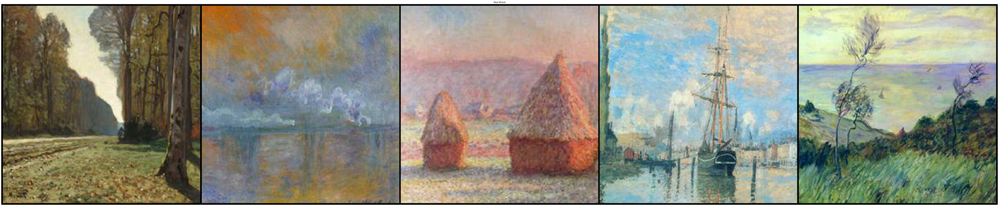

In [38]:
plt.figure(figsize=[100, 100])
plt.imshow(temp_real_Monet.cpu().permute(1,2,0))
plt.title('Real Monet')
plt.axis('off');

In [39]:
print(temp_real_Monet.shape)
print(temp_fake_Photo.shape)
print(temp_real_Photo.shape)
print(temp_fake_Monet.shape)

torch.Size([3, 260, 1292])
torch.Size([3, 260, 1292])
torch.Size([3, 260, 1292])
torch.Size([3, 260, 1292])


In [40]:
temp_image_grid = torch.cat((temp_real_Monet, temp_fake_Monet, temp_real_Photo, temp_fake_Photo), 1)
print(temp_image_grid.shape)

torch.Size([3, 1040, 1292])


In [41]:
temp_image_grid.cpu().permute(1,2,0).shape

torch.Size([1040, 1292, 3])

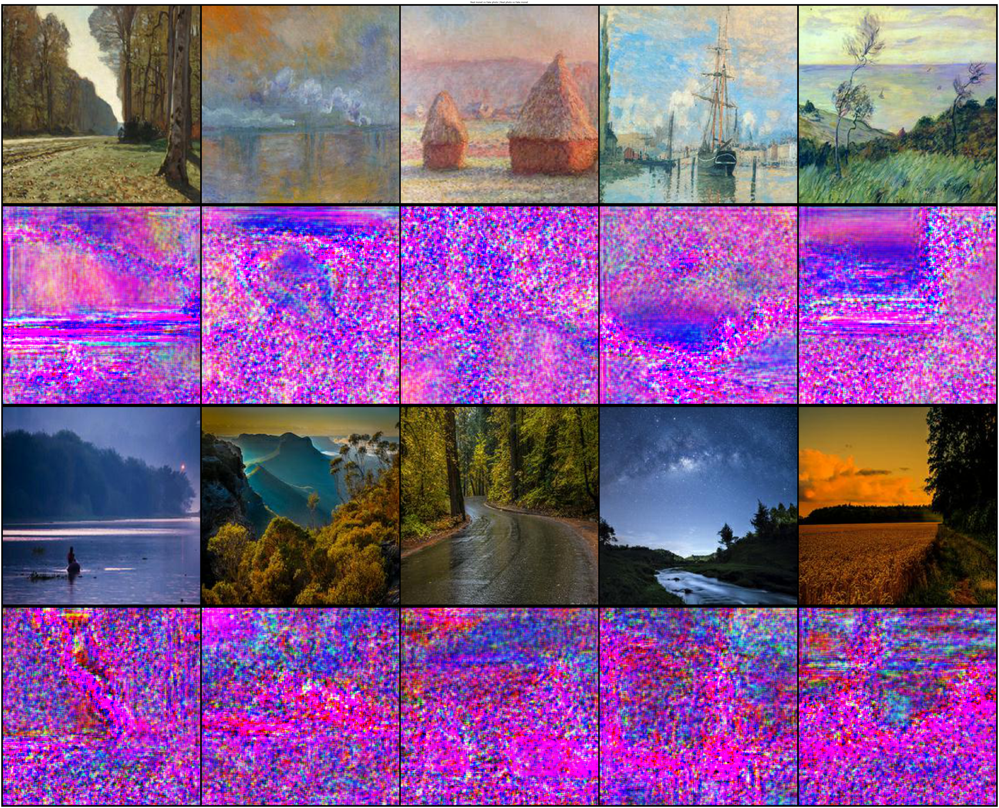

In [44]:
plt.figure(figsize=[100, 100])
plt.imshow(temp_image_grid.cpu().permute(1,2,0))
plt.title('Real monet vs Fake photo | Real photo vs Fake monet ')
plt.axis('off');

### Step 14. Training

In [45]:
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import warnings

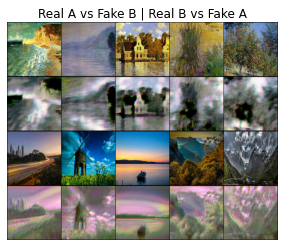

[Epoch 1/30] [Batch 50/250] [D loss : 0.323981] [G loss : 3.844773 - (adv : 0.321007, cycle : 0.239181, identity : 0.226391)]


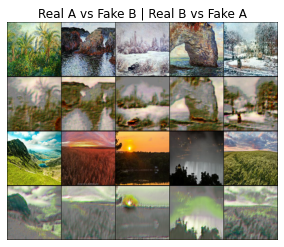

[Epoch 1/30] [Batch 100/250] [D loss : 0.231374] [G loss : 5.206561 - (adv : 0.433237, cycle : 0.322392, identity : 0.309881)]


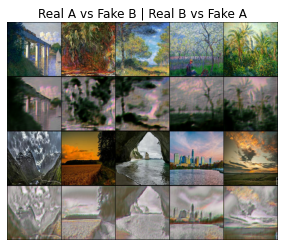

[Epoch 1/30] [Batch 150/250] [D loss : 0.309250] [G loss : 5.796967 - (adv : 0.371870, cycle : 0.368909, identity : 0.347202)]


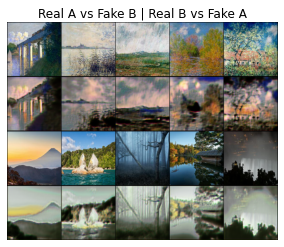

[Epoch 1/30] [Batch 200/250] [D loss : 0.218261] [G loss : 5.989597 - (adv : 0.461758, cycle : 0.388348, identity : 0.328871)]


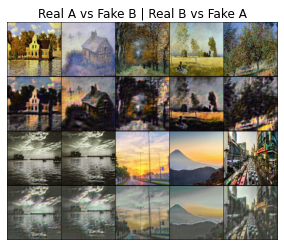

[Epoch 1/30] [Batch 250/250] [D loss : 0.316392] [G loss : 4.623195 - (adv : 0.354230, cycle : 0.287286, identity : 0.279221)]

[5.467312960624695]


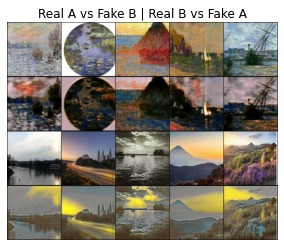

[Epoch 2/30] [Batch 50/250] [D loss : 0.368842] [G loss : 5.252025 - (adv : 0.447893, cycle : 0.331017, identity : 0.298792)]


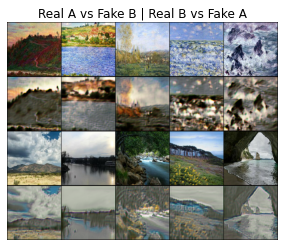

[Epoch 2/30] [Batch 100/250] [D loss : 0.214282] [G loss : 3.385902 - (adv : 0.308707, cycle : 0.214099, identity : 0.187241)]


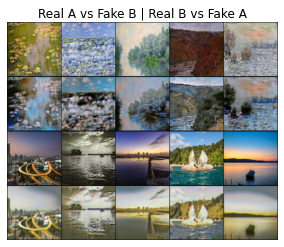

[Epoch 2/30] [Batch 150/250] [D loss : 0.305336] [G loss : 3.260369 - (adv : 0.259346, cycle : 0.206852, identity : 0.186500)]


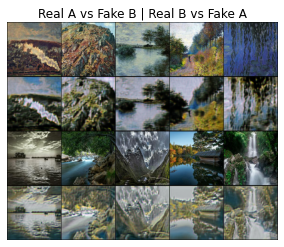

[Epoch 2/30] [Batch 200/250] [D loss : 0.348440] [G loss : 6.018199 - (adv : 0.494567, cycle : 0.381333, identity : 0.342061)]


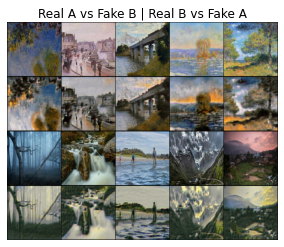

[Epoch 2/30] [Batch 250/250] [D loss : 0.243904] [G loss : 4.393792 - (adv : 0.249943, cycle : 0.283957, identity : 0.260856)]

[5.467312960624695, 4.678128311157226]


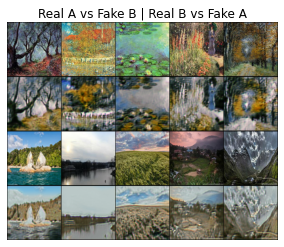

[Epoch 3/30] [Batch 50/250] [D loss : 0.277748] [G loss : 4.080422 - (adv : 0.453401, cycle : 0.241832, identity : 0.241740)]


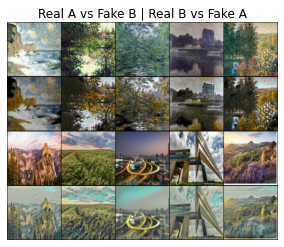

[Epoch 3/30] [Batch 100/250] [D loss : 0.206295] [G loss : 4.307461 - (adv : 0.344707, cycle : 0.276690, identity : 0.239172)]


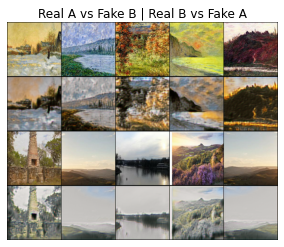

[Epoch 3/30] [Batch 150/250] [D loss : 0.304375] [G loss : 4.616122 - (adv : 0.374595, cycle : 0.286635, identity : 0.275035)]


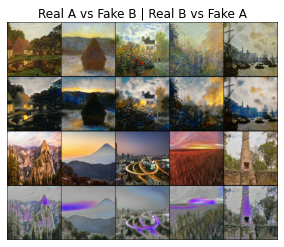

[Epoch 3/30] [Batch 200/250] [D loss : 0.362010] [G loss : 4.805174 - (adv : 0.393744, cycle : 0.285941, identity : 0.310404)]


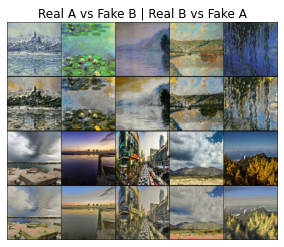

[Epoch 3/30] [Batch 250/250] [D loss : 0.286354] [G loss : 4.208089 - (adv : 0.488858, cycle : 0.248080, identity : 0.247686)]

[5.467312960624695, 4.678128311157226, 4.309761573791504]


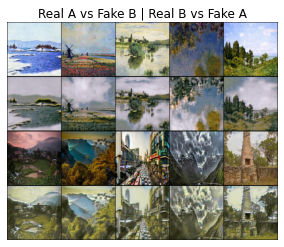

[Epoch 4/30] [Batch 50/250] [D loss : 0.211320] [G loss : 3.834556 - (adv : 0.327665, cycle : 0.240390, identity : 0.220599)]


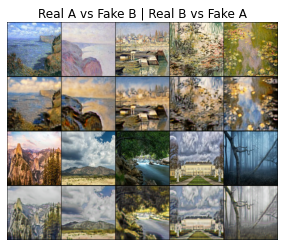

[Epoch 4/30] [Batch 100/250] [D loss : 0.261298] [G loss : 4.571435 - (adv : 0.325931, cycle : 0.318675, identity : 0.211751)]


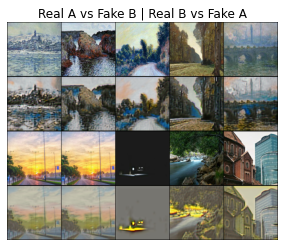

[Epoch 4/30] [Batch 150/250] [D loss : 0.136181] [G loss : 3.665936 - (adv : 0.460106, cycle : 0.217234, identity : 0.206697)]


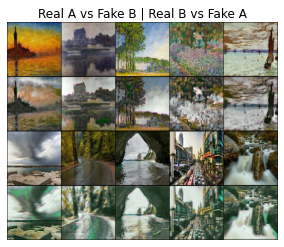

[Epoch 4/30] [Batch 200/250] [D loss : 0.216167] [G loss : 5.246527 - (adv : 0.529025, cycle : 0.326618, identity : 0.290265)]


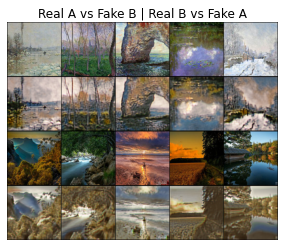

[Epoch 4/30] [Batch 250/250] [D loss : 0.092883] [G loss : 5.070190 - (adv : 0.552304, cycle : 0.317905, identity : 0.267767)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662]


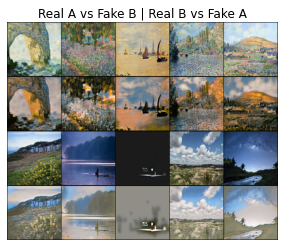

[Epoch 5/30] [Batch 50/250] [D loss : 0.144070] [G loss : 3.102453 - (adv : 0.593241, cycle : 0.178432, identity : 0.144978)]


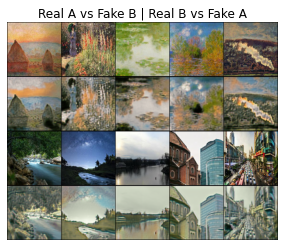

[Epoch 5/30] [Batch 100/250] [D loss : 0.188439] [G loss : 3.734464 - (adv : 0.351418, cycle : 0.225315, identity : 0.225979)]


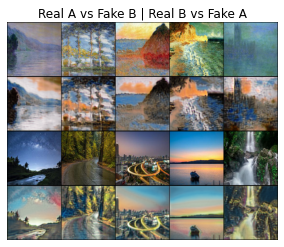

[Epoch 5/30] [Batch 150/250] [D loss : 0.434159] [G loss : 3.537700 - (adv : 0.487523, cycle : 0.215562, identity : 0.178911)]


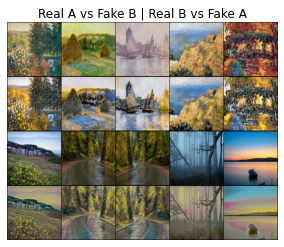

[Epoch 5/30] [Batch 200/250] [D loss : 0.247817] [G loss : 4.553405 - (adv : 0.443285, cycle : 0.268675, identity : 0.284675)]


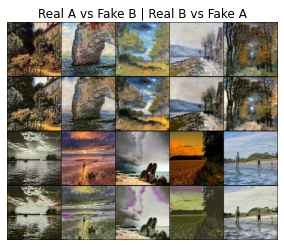

[Epoch 5/30] [Batch 250/250] [D loss : 0.279090] [G loss : 3.601069 - (adv : 0.648728, cycle : 0.205778, identity : 0.178913)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471]


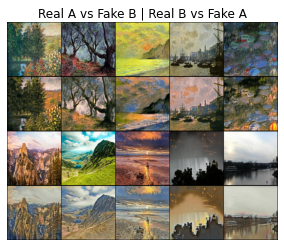

[Epoch 6/30] [Batch 50/250] [D loss : 0.217267] [G loss : 4.268105 - (adv : 0.541025, cycle : 0.260104, identity : 0.225208)]


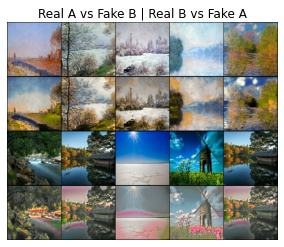

[Epoch 6/30] [Batch 100/250] [D loss : 0.262300] [G loss : 4.320084 - (adv : 0.364489, cycle : 0.268798, identity : 0.253523)]


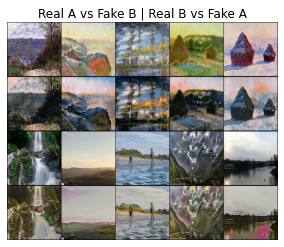

[Epoch 6/30] [Batch 150/250] [D loss : 0.199306] [G loss : 3.493942 - (adv : 0.312008, cycle : 0.224185, identity : 0.188016)]


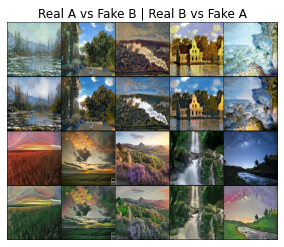

[Epoch 6/30] [Batch 200/250] [D loss : 0.235256] [G loss : 3.453502 - (adv : 0.386303, cycle : 0.207577, identity : 0.198285)]


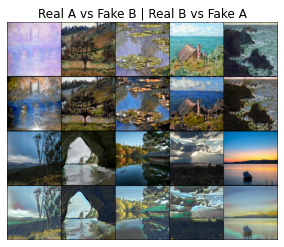

[Epoch 6/30] [Batch 250/250] [D loss : 0.132862] [G loss : 3.605355 - (adv : 0.890550, cycle : 0.186384, identity : 0.170192)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014]


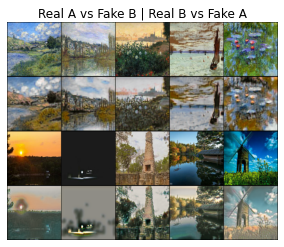

[Epoch 7/30] [Batch 50/250] [D loss : 0.186251] [G loss : 3.341578 - (adv : 0.635603, cycle : 0.180873, identity : 0.179450)]


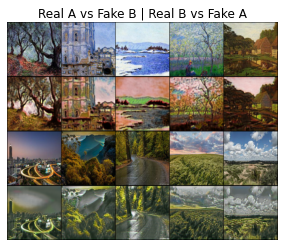

[Epoch 7/30] [Batch 100/250] [D loss : 0.219146] [G loss : 3.909187 - (adv : 0.455275, cycle : 0.204659, identity : 0.281464)]


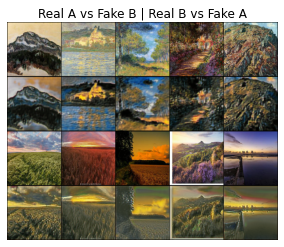

[Epoch 7/30] [Batch 150/250] [D loss : 0.254019] [G loss : 4.131741 - (adv : 0.528553, cycle : 0.241826, identity : 0.236986)]


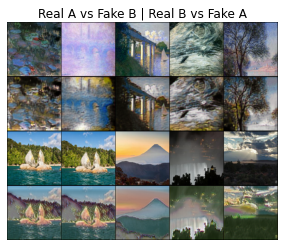

[Epoch 7/30] [Batch 200/250] [D loss : 0.155608] [G loss : 2.553449 - (adv : 0.422369, cycle : 0.147457, identity : 0.131301)]


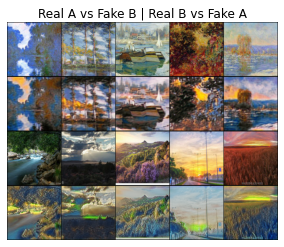

[Epoch 7/30] [Batch 250/250] [D loss : 0.212426] [G loss : 3.428813 - (adv : 0.444158, cycle : 0.211512, identity : 0.173907)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156]


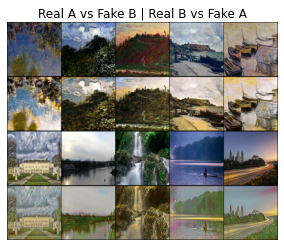

[Epoch 8/30] [Batch 50/250] [D loss : 0.250949] [G loss : 3.491658 - (adv : 0.483206, cycle : 0.203979, identity : 0.193731)]


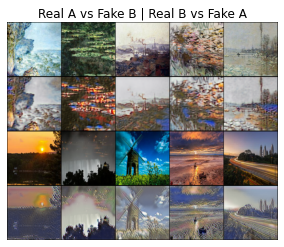

[Epoch 8/30] [Batch 100/250] [D loss : 0.164801] [G loss : 3.886797 - (adv : 0.368421, cycle : 0.224168, identity : 0.255340)]


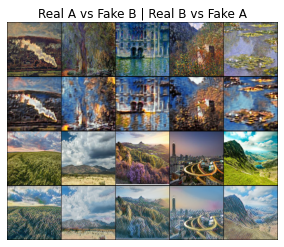

[Epoch 8/30] [Batch 150/250] [D loss : 0.316758] [G loss : 3.125624 - (adv : 0.688615, cycle : 0.166407, identity : 0.154588)]


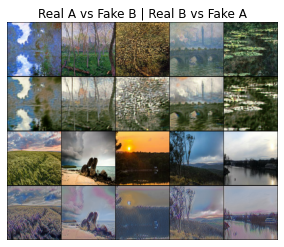

[Epoch 8/30] [Batch 200/250] [D loss : 0.200982] [G loss : 4.517582 - (adv : 0.525565, cycle : 0.281713, identity : 0.234978)]


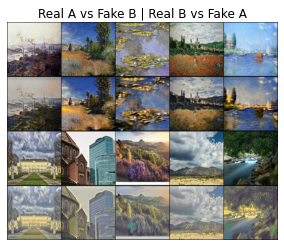

[Epoch 8/30] [Batch 250/250] [D loss : 0.147093] [G loss : 3.458069 - (adv : 0.444542, cycle : 0.206310, identity : 0.190085)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245]


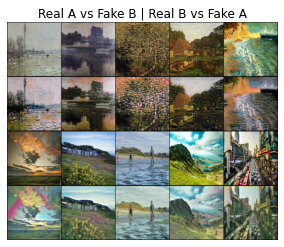

[Epoch 9/30] [Batch 50/250] [D loss : 0.253581] [G loss : 3.252678 - (adv : 0.472263, cycle : 0.190295, identity : 0.175493)]


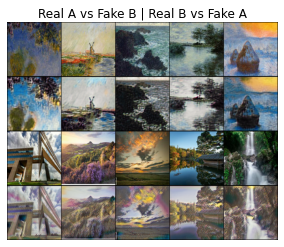

[Epoch 9/30] [Batch 100/250] [D loss : 0.071440] [G loss : 2.531719 - (adv : 0.625503, cycle : 0.132156, identity : 0.116931)]


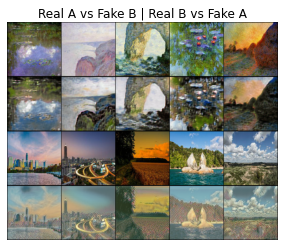

[Epoch 9/30] [Batch 150/250] [D loss : 0.287621] [G loss : 3.626756 - (adv : 0.401297, cycle : 0.209661, identity : 0.225770)]


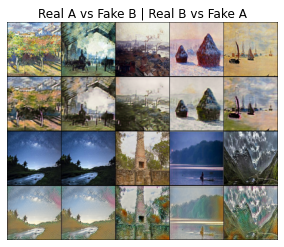

[Epoch 9/30] [Batch 200/250] [D loss : 0.238483] [G loss : 2.489827 - (adv : 0.552185, cycle : 0.135321, identity : 0.116886)]


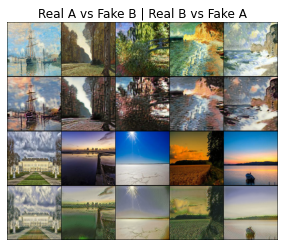

[Epoch 9/30] [Batch 250/250] [D loss : 0.164915] [G loss : 3.857125 - (adv : 0.630209, cycle : 0.208617, identity : 0.228149)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823]


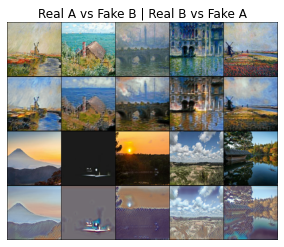

[Epoch 10/30] [Batch 50/250] [D loss : 0.235621] [G loss : 3.908662 - (adv : 0.920173, cycle : 0.196101, identity : 0.205496)]


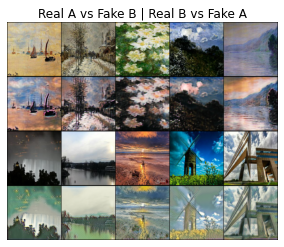

[Epoch 10/30] [Batch 100/250] [D loss : 0.270580] [G loss : 3.670430 - (adv : 0.627651, cycle : 0.214947, identity : 0.178661)]


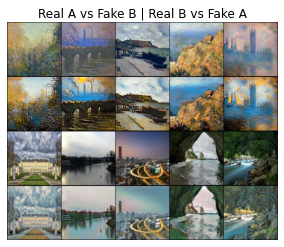

[Epoch 10/30] [Batch 150/250] [D loss : 0.184198] [G loss : 3.900237 - (adv : 0.511202, cycle : 0.237443, identity : 0.202920)]


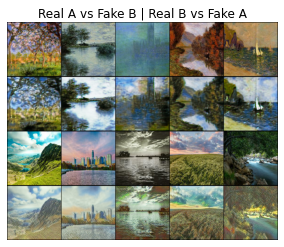

[Epoch 10/30] [Batch 200/250] [D loss : 0.098269] [G loss : 2.972266 - (adv : 0.522299, cycle : 0.165901, identity : 0.158191)]


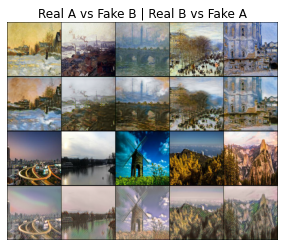

[Epoch 10/30] [Batch 250/250] [D loss : 0.289855] [G loss : 3.431202 - (adv : 0.514218, cycle : 0.204468, identity : 0.174460)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706]


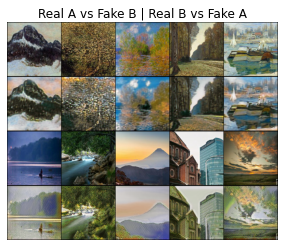

[Epoch 11/30] [Batch 50/250] [D loss : 0.159284] [G loss : 3.220612 - (adv : 0.367967, cycle : 0.190195, identity : 0.190138)]


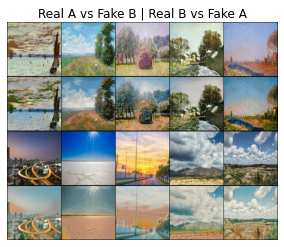

[Epoch 11/30] [Batch 100/250] [D loss : 0.173602] [G loss : 3.220357 - (adv : 0.403672, cycle : 0.209960, identity : 0.143418)]


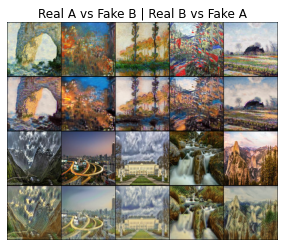

[Epoch 11/30] [Batch 150/250] [D loss : 0.251363] [G loss : 2.583610 - (adv : 0.289047, cycle : 0.152503, identity : 0.153907)]


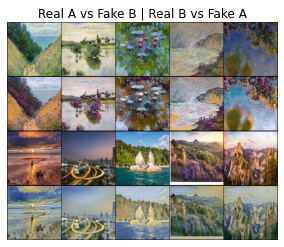

[Epoch 11/30] [Batch 200/250] [D loss : 0.166975] [G loss : 5.156338 - (adv : 0.328356, cycle : 0.331010, identity : 0.303577)]


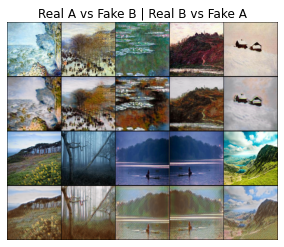

[Epoch 11/30] [Batch 250/250] [D loss : 0.226008] [G loss : 3.336269 - (adv : 0.495071, cycle : 0.198615, identity : 0.171010)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923]


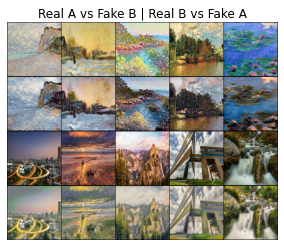

[Epoch 12/30] [Batch 50/250] [D loss : 0.082581] [G loss : 3.634905 - (adv : 0.779124, cycle : 0.204609, identity : 0.161937)]


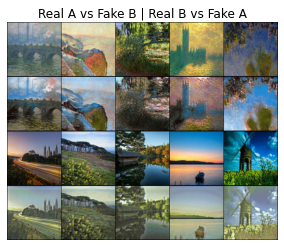

[Epoch 12/30] [Batch 100/250] [D loss : 0.267387] [G loss : 4.050346 - (adv : 0.566098, cycle : 0.219137, identity : 0.258576)]


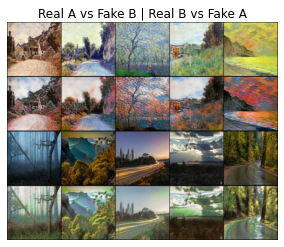

[Epoch 12/30] [Batch 150/250] [D loss : 0.206722] [G loss : 3.420053 - (adv : 0.598864, cycle : 0.181377, identity : 0.201484)]


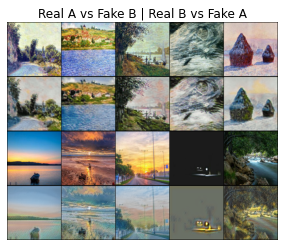

[Epoch 12/30] [Batch 200/250] [D loss : 0.140323] [G loss : 2.337694 - (adv : 0.394173, cycle : 0.128224, identity : 0.132257)]


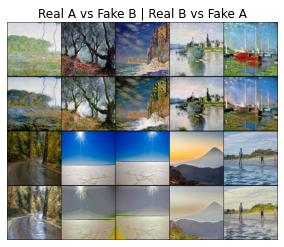

[Epoch 12/30] [Batch 250/250] [D loss : 0.119856] [G loss : 3.791381 - (adv : 0.668490, cycle : 0.213410, identity : 0.197758)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518]


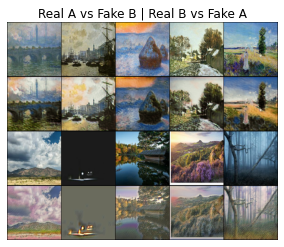

[Epoch 13/30] [Batch 50/250] [D loss : 0.229022] [G loss : 3.618677 - (adv : 0.670256, cycle : 0.207214, identity : 0.175256)]


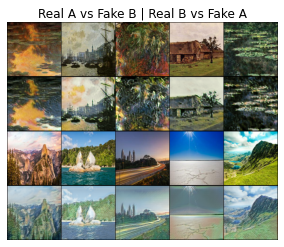

[Epoch 13/30] [Batch 100/250] [D loss : 0.129700] [G loss : 2.474574 - (adv : 0.491715, cycle : 0.136671, identity : 0.123230)]


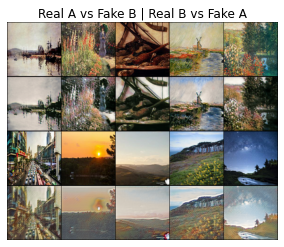

[Epoch 13/30] [Batch 150/250] [D loss : 0.264628] [G loss : 2.930925 - (adv : 0.434331, cycle : 0.167090, identity : 0.165139)]


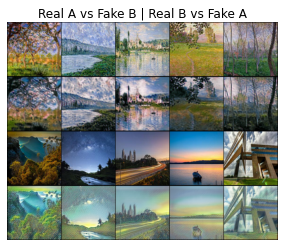

[Epoch 13/30] [Batch 200/250] [D loss : 0.237936] [G loss : 3.698769 - (adv : 0.415856, cycle : 0.238909, identity : 0.178764)]


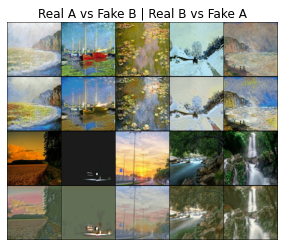

[Epoch 13/30] [Batch 250/250] [D loss : 0.119186] [G loss : 2.821663 - (adv : 0.489509, cycle : 0.159210, identity : 0.148010)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633]


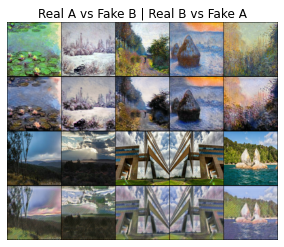

[Epoch 14/30] [Batch 50/250] [D loss : 0.340560] [G loss : 3.403372 - (adv : 0.290493, cycle : 0.217116, identity : 0.188343)]


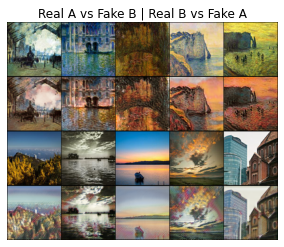

[Epoch 14/30] [Batch 100/250] [D loss : 0.174635] [G loss : 3.948698 - (adv : 0.388309, cycle : 0.239846, identity : 0.232385)]


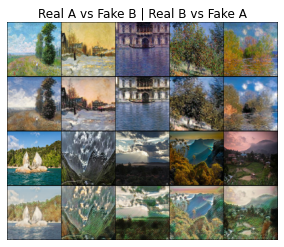

[Epoch 14/30] [Batch 150/250] [D loss : 0.104860] [G loss : 4.010428 - (adv : 0.711632, cycle : 0.209277, identity : 0.241206)]


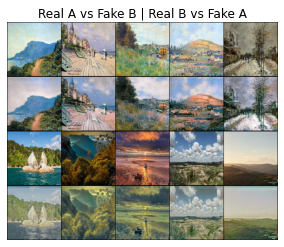

[Epoch 14/30] [Batch 200/250] [D loss : 0.207119] [G loss : 3.516928 - (adv : 1.262025, cycle : 0.158624, identity : 0.133732)]


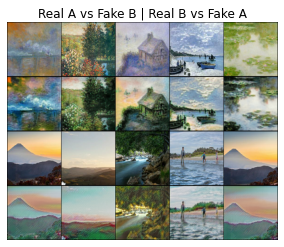

[Epoch 14/30] [Batch 250/250] [D loss : 0.383053] [G loss : 2.619066 - (adv : 0.332629, cycle : 0.148717, identity : 0.159853)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313]


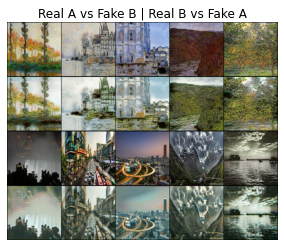

[Epoch 15/30] [Batch 50/250] [D loss : 0.344283] [G loss : 2.982319 - (adv : 0.313924, cycle : 0.180808, identity : 0.172062)]


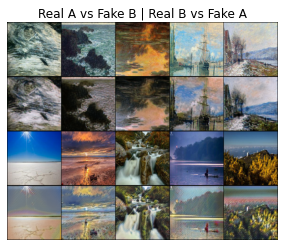

[Epoch 15/30] [Batch 100/250] [D loss : 0.068976] [G loss : 3.680059 - (adv : 0.988777, cycle : 0.190449, identity : 0.157357)]


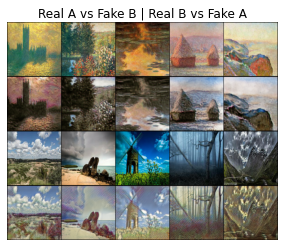

[Epoch 15/30] [Batch 150/250] [D loss : 0.240858] [G loss : 3.406069 - (adv : 0.317133, cycle : 0.198487, identity : 0.220813)]


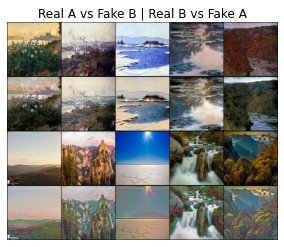

[Epoch 15/30] [Batch 200/250] [D loss : 0.134883] [G loss : 4.204361 - (adv : 0.995535, cycle : 0.221178, identity : 0.199410)]


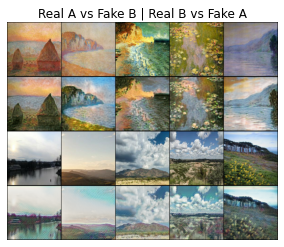

[Epoch 15/30] [Batch 250/250] [D loss : 0.171747] [G loss : 4.491634 - (adv : 0.505823, cycle : 0.274183, identity : 0.248797)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027]


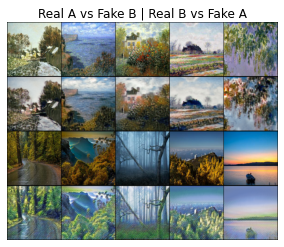

[Epoch 16/30] [Batch 50/250] [D loss : 0.091700] [G loss : 2.697365 - (adv : 0.499613, cycle : 0.153155, identity : 0.133241)]


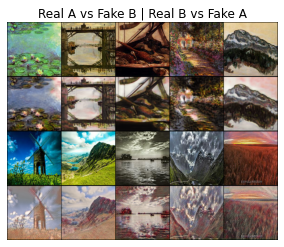

[Epoch 16/30] [Batch 100/250] [D loss : 0.159312] [G loss : 4.420674 - (adv : 0.851549, cycle : 0.250221, identity : 0.213383)]


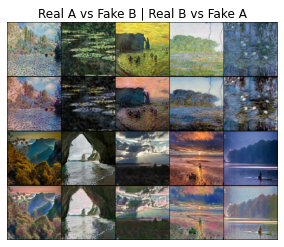

[Epoch 16/30] [Batch 150/250] [D loss : 0.237568] [G loss : 3.825181 - (adv : 1.201092, cycle : 0.179535, identity : 0.165747)]


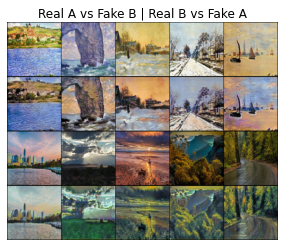

[Epoch 16/30] [Batch 200/250] [D loss : 0.145056] [G loss : 3.454348 - (adv : 0.834665, cycle : 0.170590, identity : 0.182756)]


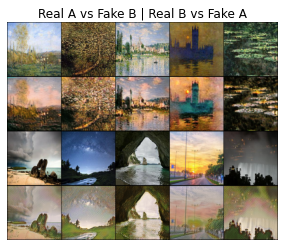

[Epoch 16/30] [Batch 250/250] [D loss : 0.276299] [G loss : 2.316552 - (adv : 0.319945, cycle : 0.134630, identity : 0.130062)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487]


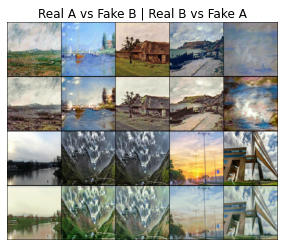

[Epoch 17/30] [Batch 50/250] [D loss : 0.202062] [G loss : 3.073233 - (adv : 0.406097, cycle : 0.186075, identity : 0.161276)]


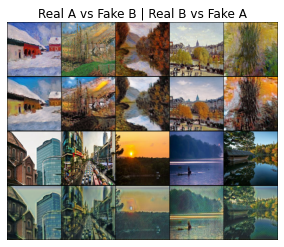

[Epoch 17/30] [Batch 100/250] [D loss : 0.237247] [G loss : 3.129585 - (adv : 0.920808, cycle : 0.147329, identity : 0.147097)]


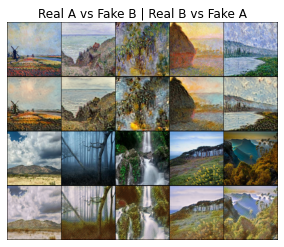

[Epoch 17/30] [Batch 150/250] [D loss : 0.112405] [G loss : 3.417501 - (adv : 0.632457, cycle : 0.194379, identity : 0.168252)]


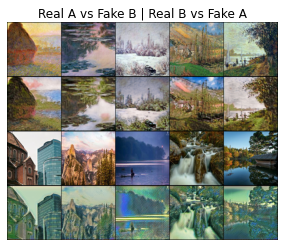

[Epoch 17/30] [Batch 200/250] [D loss : 0.082023] [G loss : 3.365588 - (adv : 0.494487, cycle : 0.186605, identity : 0.201011)]


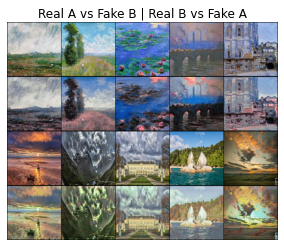

[Epoch 17/30] [Batch 250/250] [D loss : 0.357600] [G loss : 3.099996 - (adv : 0.673653, cycle : 0.166270, identity : 0.152728)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937]


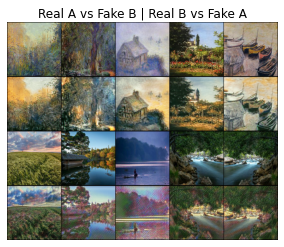

[Epoch 18/30] [Batch 50/250] [D loss : 0.131931] [G loss : 3.160584 - (adv : 0.519027, cycle : 0.187204, identity : 0.153903)]


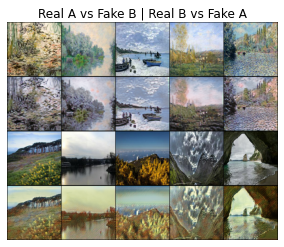

[Epoch 18/30] [Batch 100/250] [D loss : 0.238418] [G loss : 2.906447 - (adv : 0.393022, cycle : 0.158904, identity : 0.184878)]


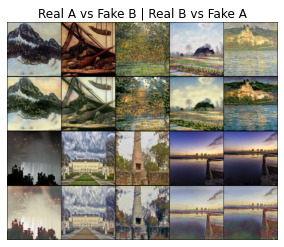

[Epoch 18/30] [Batch 150/250] [D loss : 0.149813] [G loss : 3.015788 - (adv : 0.906161, cycle : 0.138881, identity : 0.144163)]


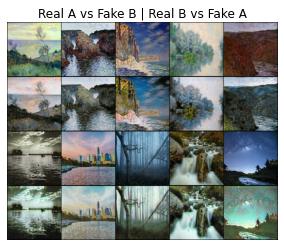

[Epoch 18/30] [Batch 200/250] [D loss : 0.212601] [G loss : 2.774887 - (adv : 0.515798, cycle : 0.163105, identity : 0.125609)]


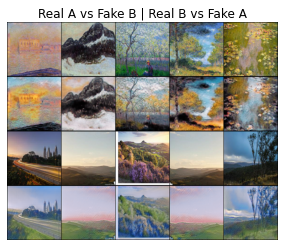

[Epoch 18/30] [Batch 250/250] [D loss : 0.099740] [G loss : 4.031808 - (adv : 0.637806, cycle : 0.256010, identity : 0.166781)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064]


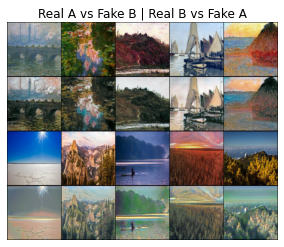

[Epoch 19/30] [Batch 50/250] [D loss : 0.187981] [G loss : 2.999567 - (adv : 0.795196, cycle : 0.151733, identity : 0.137409)]


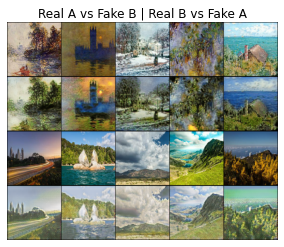

[Epoch 19/30] [Batch 100/250] [D loss : 0.101753] [G loss : 2.687127 - (adv : 1.077314, cycle : 0.113598, identity : 0.094766)]


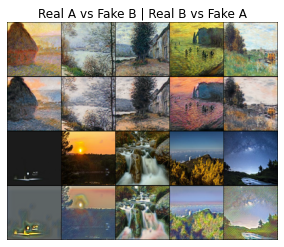

[Epoch 19/30] [Batch 150/250] [D loss : 0.251803] [G loss : 2.952305 - (adv : 0.773397, cycle : 0.134543, identity : 0.166696)]


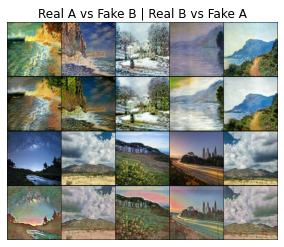

[Epoch 19/30] [Batch 200/250] [D loss : 0.229181] [G loss : 3.345726 - (adv : 0.684280, cycle : 0.177311, identity : 0.177667)]


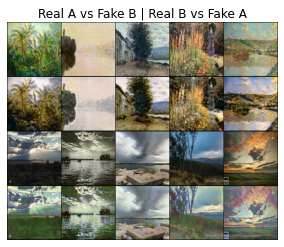

[Epoch 19/30] [Batch 250/250] [D loss : 0.196306] [G loss : 2.580514 - (adv : 0.317953, cycle : 0.150759, identity : 0.150994)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064, 3.231448489665985]


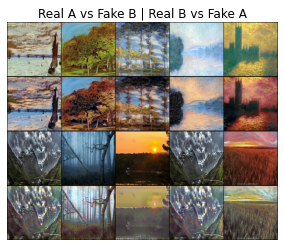

[Epoch 20/30] [Batch 50/250] [D loss : 0.138098] [G loss : 3.232242 - (adv : 0.771866, cycle : 0.165402, identity : 0.161271)]


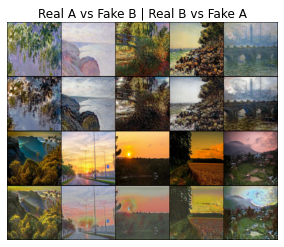

[Epoch 20/30] [Batch 100/250] [D loss : 0.065189] [G loss : 2.716651 - (adv : 0.784932, cycle : 0.131758, identity : 0.122828)]


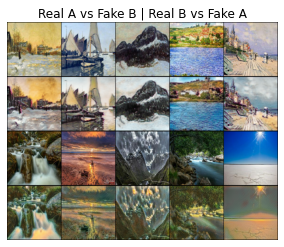

[Epoch 20/30] [Batch 150/250] [D loss : 0.240633] [G loss : 2.878207 - (adv : 0.175177, cycle : 0.186301, identity : 0.168005)]


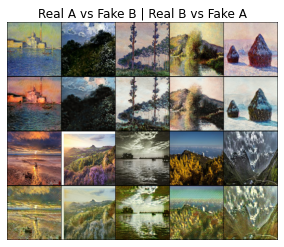

[Epoch 20/30] [Batch 200/250] [D loss : 0.226917] [G loss : 3.316821 - (adv : 0.663609, cycle : 0.185232, identity : 0.160178)]


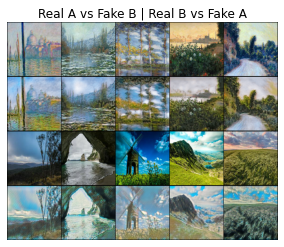

[Epoch 20/30] [Batch 250/250] [D loss : 0.282730] [G loss : 3.222211 - (adv : 0.565939, cycle : 0.188740, identity : 0.153774)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064, 3.231448489665985, 3.0578654952049256]


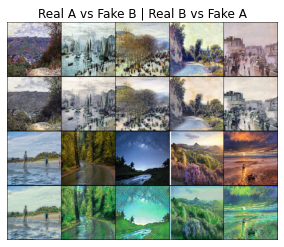

[Epoch 21/30] [Batch 50/250] [D loss : 0.300676] [G loss : 2.961367 - (adv : 0.886035, cycle : 0.141400, identity : 0.132266)]


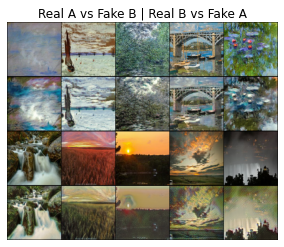

[Epoch 21/30] [Batch 100/250] [D loss : 0.107270] [G loss : 2.829870 - (adv : 0.731829, cycle : 0.142378, identity : 0.134851)]


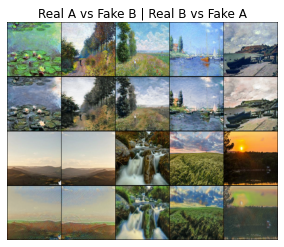

[Epoch 21/30] [Batch 150/250] [D loss : 0.203219] [G loss : 2.490530 - (adv : 0.532207, cycle : 0.142049, identity : 0.107568)]


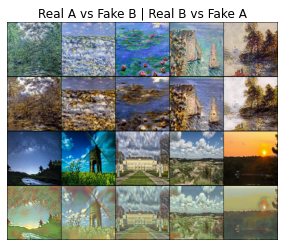

[Epoch 21/30] [Batch 200/250] [D loss : 0.165780] [G loss : 3.261866 - (adv : 0.503752, cycle : 0.189690, identity : 0.172243)]


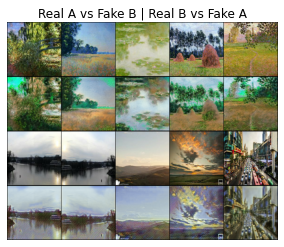

[Epoch 21/30] [Batch 250/250] [D loss : 0.154953] [G loss : 4.476130 - (adv : 0.782717, cycle : 0.249500, identity : 0.239682)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064, 3.231448489665985, 3.0578654952049256, 3.1294173765182496]


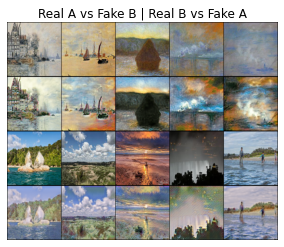

[Epoch 22/30] [Batch 50/250] [D loss : 0.106351] [G loss : 3.326656 - (adv : 0.657215, cycle : 0.187819, identity : 0.158251)]


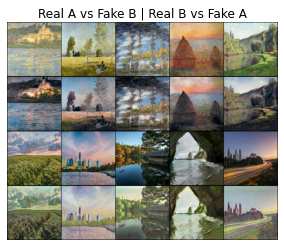

[Epoch 22/30] [Batch 100/250] [D loss : 0.180191] [G loss : 3.309933 - (adv : 0.361902, cycle : 0.200076, identity : 0.189454)]


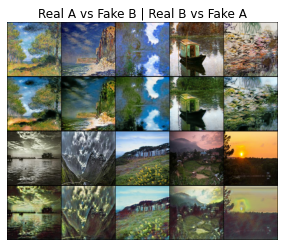

[Epoch 22/30] [Batch 150/250] [D loss : 0.202771] [G loss : 3.041198 - (adv : 0.794767, cycle : 0.155399, identity : 0.138488)]


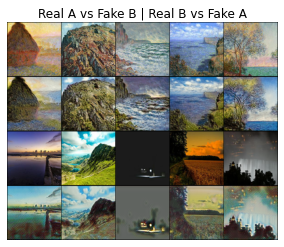

[Epoch 22/30] [Batch 200/250] [D loss : 0.074739] [G loss : 3.596778 - (adv : 0.549734, cycle : 0.224878, identity : 0.159653)]


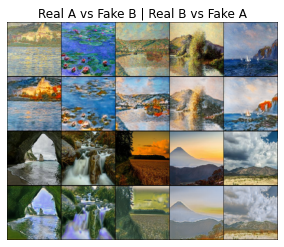

[Epoch 22/30] [Batch 250/250] [D loss : 0.085535] [G loss : 3.183932 - (adv : 0.532264, cycle : 0.197248, identity : 0.135838)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064, 3.231448489665985, 3.0578654952049256, 3.1294173765182496, 3.2475172719955445]


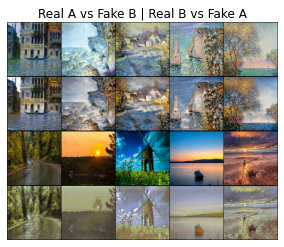

[Epoch 23/30] [Batch 50/250] [D loss : 0.169927] [G loss : 3.049978 - (adv : 0.705167, cycle : 0.154099, identity : 0.160764)]


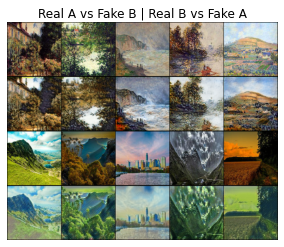

[Epoch 23/30] [Batch 100/250] [D loss : 0.102931] [G loss : 3.318897 - (adv : 0.897217, cycle : 0.173427, identity : 0.137482)]


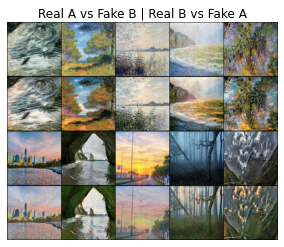

[Epoch 23/30] [Batch 150/250] [D loss : 0.096080] [G loss : 2.901471 - (adv : 0.841292, cycle : 0.155462, identity : 0.101112)]


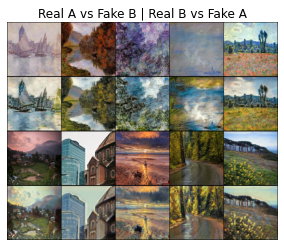

[Epoch 23/30] [Batch 200/250] [D loss : 0.146456] [G loss : 2.853011 - (adv : 0.864982, cycle : 0.142217, identity : 0.113172)]


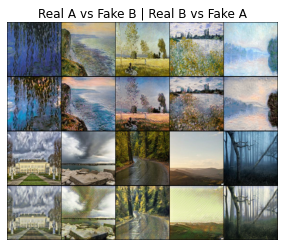

[Epoch 23/30] [Batch 250/250] [D loss : 0.073003] [G loss : 2.548042 - (adv : 0.787021, cycle : 0.123101, identity : 0.106002)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064, 3.231448489665985, 3.0578654952049256, 3.1294173765182496, 3.2475172719955445, 3.0836252813339233]


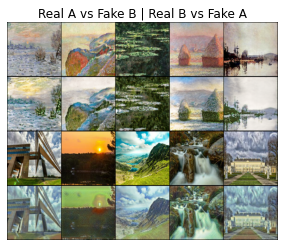

[Epoch 24/30] [Batch 50/250] [D loss : 0.103088] [G loss : 3.145485 - (adv : 0.560166, cycle : 0.176336, identity : 0.164392)]


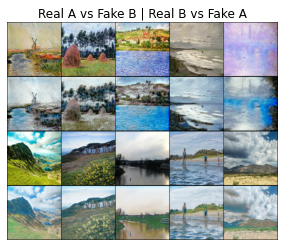

[Epoch 24/30] [Batch 100/250] [D loss : 0.077198] [G loss : 3.120714 - (adv : 0.777881, cycle : 0.164074, identity : 0.140418)]


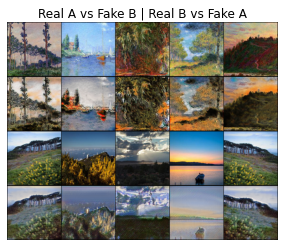

[Epoch 24/30] [Batch 150/250] [D loss : 0.128514] [G loss : 3.659381 - (adv : 1.279903, cycle : 0.180484, identity : 0.114928)]


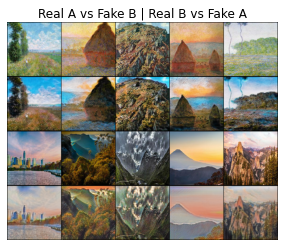

[Epoch 24/30] [Batch 200/250] [D loss : 0.199059] [G loss : 3.540994 - (adv : 1.144018, cycle : 0.163488, identity : 0.152419)]


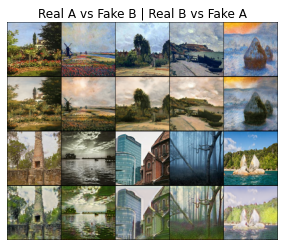

[Epoch 24/30] [Batch 250/250] [D loss : 0.527736] [G loss : 3.512070 - (adv : 0.514047, cycle : 0.191098, identity : 0.217408)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064, 3.231448489665985, 3.0578654952049256, 3.1294173765182496, 3.2475172719955445, 3.0836252813339233, 3.0648348112106323]


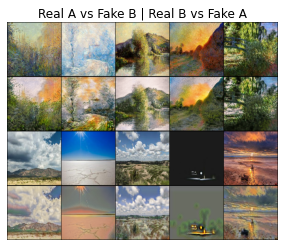

[Epoch 25/30] [Batch 50/250] [D loss : 0.287577] [G loss : 2.841329 - (adv : 0.753570, cycle : 0.139894, identity : 0.137764)]


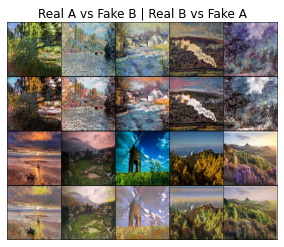

[Epoch 25/30] [Batch 100/250] [D loss : 0.132124] [G loss : 3.892353 - (adv : 0.482364, cycle : 0.251166, identity : 0.179665)]


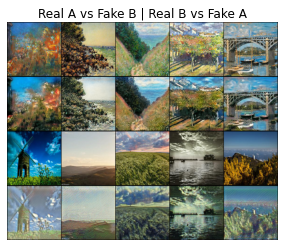

[Epoch 25/30] [Batch 150/250] [D loss : 0.096910] [G loss : 3.265060 - (adv : 0.783125, cycle : 0.165652, identity : 0.165082)]


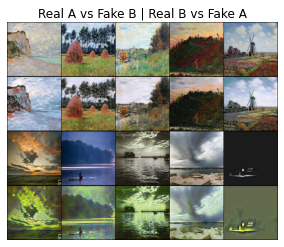

[Epoch 25/30] [Batch 200/250] [D loss : 0.246002] [G loss : 2.804950 - (adv : 0.411733, cycle : 0.164462, identity : 0.149720)]


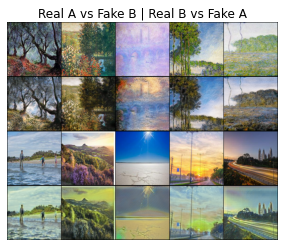

[Epoch 25/30] [Batch 250/250] [D loss : 0.094502] [G loss : 2.667143 - (adv : 0.509836, cycle : 0.153544, identity : 0.124373)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064, 3.231448489665985, 3.0578654952049256, 3.1294173765182496, 3.2475172719955445, 3.0836252813339233, 3.0648348112106323, 2.965058762550354]


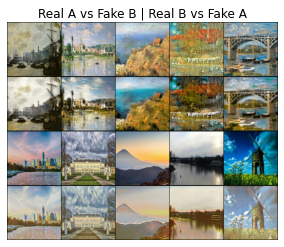

[Epoch 26/30] [Batch 50/250] [D loss : 0.223126] [G loss : 2.397023 - (adv : 0.401475, cycle : 0.137373, identity : 0.124363)]


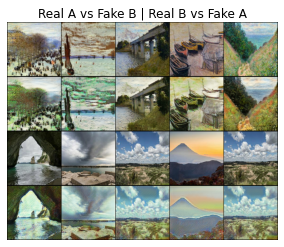

[Epoch 26/30] [Batch 100/250] [D loss : 0.132397] [G loss : 2.875014 - (adv : 0.578628, cycle : 0.153931, identity : 0.151415)]


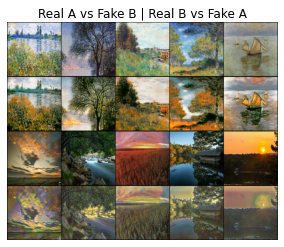

[Epoch 26/30] [Batch 150/250] [D loss : 0.215589] [G loss : 4.000029 - (adv : 0.948851, cycle : 0.221484, identity : 0.167267)]


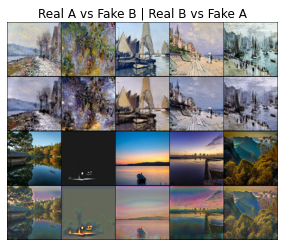

[Epoch 26/30] [Batch 200/250] [D loss : 0.315486] [G loss : 2.612090 - (adv : 0.507682, cycle : 0.137983, identity : 0.144915)]


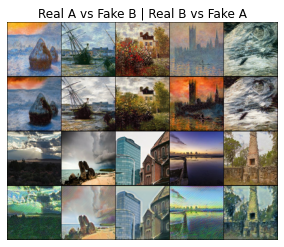

[Epoch 26/30] [Batch 250/250] [D loss : 0.084654] [G loss : 2.047559 - (adv : 0.636588, cycle : 0.098928, identity : 0.084338)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064, 3.231448489665985, 3.0578654952049256, 3.1294173765182496, 3.2475172719955445, 3.0836252813339233, 3.0648348112106323, 2.965058762550354, 2.884037434577942]


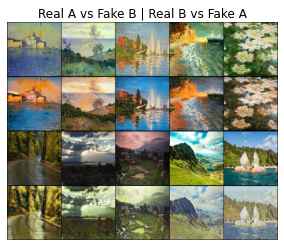

[Epoch 27/30] [Batch 50/250] [D loss : 0.137325] [G loss : 3.972334 - (adv : 0.710053, cycle : 0.244069, identity : 0.164318)]


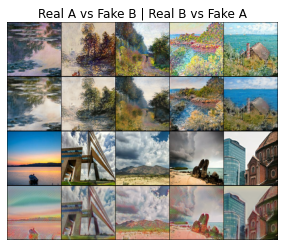

[Epoch 27/30] [Batch 100/250] [D loss : 0.117197] [G loss : 2.798119 - (adv : 0.604409, cycle : 0.137916, identity : 0.162909)]


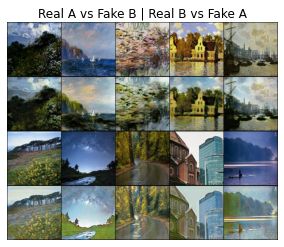

[Epoch 27/30] [Batch 150/250] [D loss : 0.079735] [G loss : 3.919865 - (adv : 0.727509, cycle : 0.211854, identity : 0.214764)]


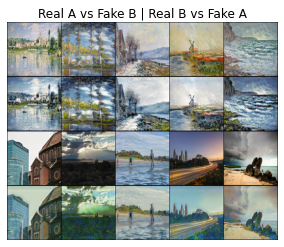

[Epoch 27/30] [Batch 200/250] [D loss : 0.161244] [G loss : 2.600587 - (adv : 0.707645, cycle : 0.124669, identity : 0.129251)]


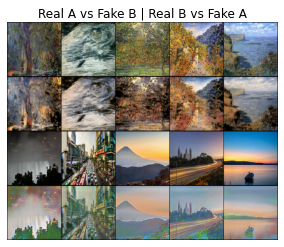

[Epoch 27/30] [Batch 250/250] [D loss : 0.159672] [G loss : 3.655964 - (adv : 0.684785, cycle : 0.201987, identity : 0.190261)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064, 3.231448489665985, 3.0578654952049256, 3.1294173765182496, 3.2475172719955445, 3.0836252813339233, 3.0648348112106323, 2.965058762550354, 2.884037434577942, 3.022648795604706]


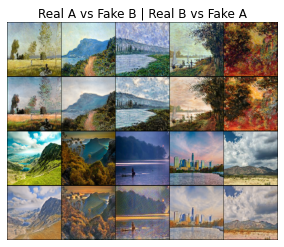

[Epoch 28/30] [Batch 50/250] [D loss : 0.118151] [G loss : 2.742043 - (adv : 0.547097, cycle : 0.147255, identity : 0.144479)]


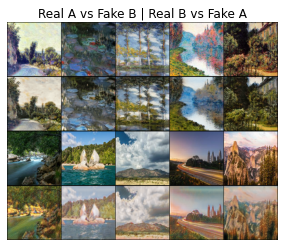

[Epoch 28/30] [Batch 100/250] [D loss : 0.154713] [G loss : 3.684116 - (adv : 0.716582, cycle : 0.206792, identity : 0.179924)]


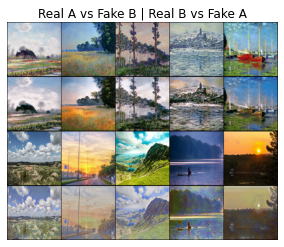

[Epoch 28/30] [Batch 150/250] [D loss : 0.101841] [G loss : 2.854941 - (adv : 0.501422, cycle : 0.153607, identity : 0.163490)]


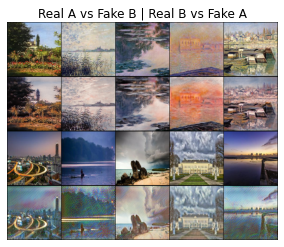

[Epoch 28/30] [Batch 200/250] [D loss : 0.226831] [G loss : 2.061368 - (adv : 0.430445, cycle : 0.113545, identity : 0.099096)]


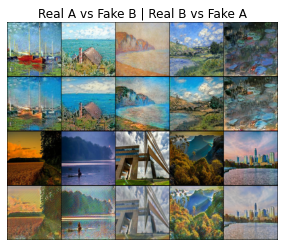

[Epoch 28/30] [Batch 250/250] [D loss : 0.139338] [G loss : 2.677743 - (adv : 0.432403, cycle : 0.162725, identity : 0.123618)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064, 3.231448489665985, 3.0578654952049256, 3.1294173765182496, 3.2475172719955445, 3.0836252813339233, 3.0648348112106323, 2.965058762550354, 2.884037434577942, 3.022648795604706, 2.874257352352142]


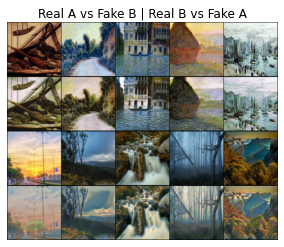

[Epoch 29/30] [Batch 50/250] [D loss : 0.175638] [G loss : 3.184536 - (adv : 0.459844, cycle : 0.195623, identity : 0.153693)]


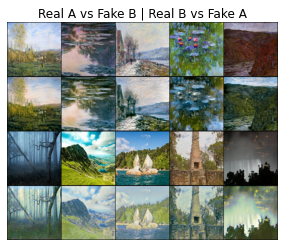

[Epoch 29/30] [Batch 100/250] [D loss : 0.224344] [G loss : 2.762640 - (adv : 0.844478, cycle : 0.130554, identity : 0.122524)]


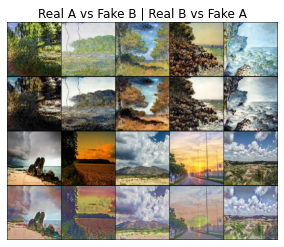

[Epoch 29/30] [Batch 150/250] [D loss : 0.166880] [G loss : 3.142627 - (adv : 0.742452, cycle : 0.164839, identity : 0.150357)]


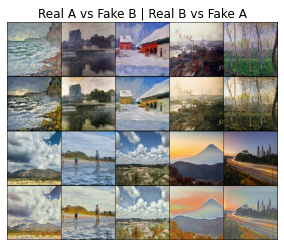

[Epoch 29/30] [Batch 200/250] [D loss : 0.147554] [G loss : 2.401613 - (adv : 0.447388, cycle : 0.129739, identity : 0.131366)]


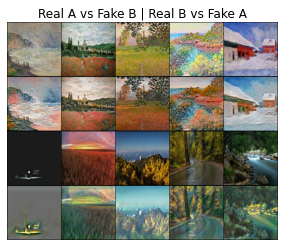

[Epoch 29/30] [Batch 250/250] [D loss : 0.313196] [G loss : 3.455873 - (adv : 0.629111, cycle : 0.211369, identity : 0.142614)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064, 3.231448489665985, 3.0578654952049256, 3.1294173765182496, 3.2475172719955445, 3.0836252813339233, 3.0648348112106323, 2.965058762550354, 2.884037434577942, 3.022648795604706, 2.874257352352142, 2.9792686500549315]


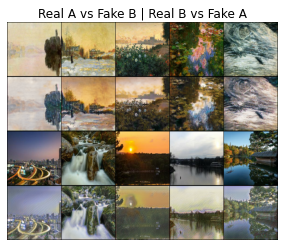

[Epoch 30/30] [Batch 50/250] [D loss : 0.040405] [G loss : 3.368737 - (adv : 0.965288, cycle : 0.167205, identity : 0.146280)]


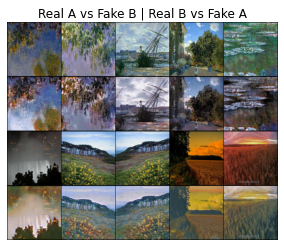

[Epoch 30/30] [Batch 100/250] [D loss : 0.140921] [G loss : 2.160804 - (adv : 0.488137, cycle : 0.111266, identity : 0.112002)]


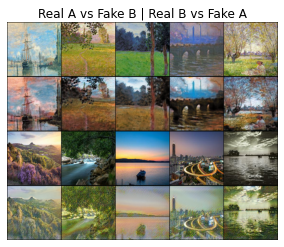

[Epoch 30/30] [Batch 150/250] [D loss : 0.211470] [G loss : 2.805895 - (adv : 0.340990, cycle : 0.174467, identity : 0.144048)]


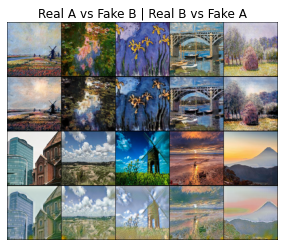

[Epoch 30/30] [Batch 200/250] [D loss : 0.199877] [G loss : 3.196984 - (adv : 0.638280, cycle : 0.182281, identity : 0.147179)]


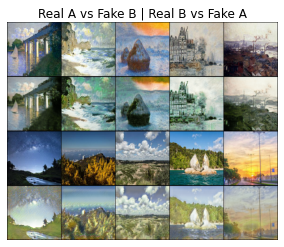

[Epoch 30/30] [Batch 250/250] [D loss : 0.203850] [G loss : 3.287767 - (adv : 0.547888, cycle : 0.205597, identity : 0.136781)]

[5.467312960624695, 4.678128311157226, 4.309761573791504, 4.138270735740662, 3.894641223907471, 3.6998090801239014, 3.7523659801483156, 3.6264321298599245, 3.60129993724823, 3.531349531173706, 3.4747628107070923, 3.424035096168518, 3.1919154043197633, 3.199042218208313, 3.3240011472702027, 3.177049927711487, 3.339489520072937, 3.1133617901802064, 3.231448489665985, 3.0578654952049256, 3.1294173765182496, 3.2475172719955445, 3.0836252813339233, 3.0648348112106323, 2.965058762550354, 2.884037434577942, 3.022648795604706, 2.874257352352142, 2.9792686500549315, 2.934335029602051]


In [46]:
loss_vals=  []
for epoch in range(epoch, n_epochs):
    epoch_loss= []
    for i, batch in enumerate(tqdm(dataloader)):
        
        # Set model input
        real_Monet = batch['A'].type(Tensor)
        real_Photo = batch['B'].type(Tensor)
        
        # Adversarial ground truths
        valid = Tensor(np.ones((real_Monet.size(0), *Discriminator_monet.output_shape))) # requires_grad = False. Default.
        fake = Tensor(np.zeros((real_Monet.size(0), *Discriminator_monet.output_shape))) # requires_grad = False. Default.
        
# -----------------
# Train Generators
# -----------------
        Generator_monet_to_photo.train() # train mode
        Generator_photo_to_monet.train() # train mode
        
        optimizer_G.zero_grad() # Integrated optimizer(Generator_monet_to_photo, Generator_photo_to_monet)
        
        # Identity Loss
        loss_Identity_Monet = criterion_identity(Generator_photo_to_monet(real_Monet), real_Monet) # If you put A into a generator that creates A with B,
        loss_Identity_Photo = criterion_identity(Generator_monet_to_photo(real_Photo), real_Photo) # then of course A must come out as it is.
                                                             # Taking this into consideration, add an identity loss that simply compares 'A and A' (or 'B and B').
        loss_identity = (loss_Identity_Monet + loss_Identity_Photo)/2
        
        # GAN Loss
        fake_Photo = Generator_monet_to_photo(real_Monet) # fake_Photo is fake-photo that generated by real monet-drawing
        loss_GAN_M2P = criterion_GAN(Discriminator_photo(fake_Photo), valid) # tricking the 'fake-B' into 'real-B'
        fake_Monet = Generator_photo_to_monet(real_Photo)
        loss_GAN_P2M = criterion_GAN(Discriminator_monet(fake_Monet), valid) # tricking the 'fake-A' into 'real-A'
        
        loss_GAN = (loss_GAN_M2P + loss_GAN_P2M)/2
        
        # Cycle Loss
        recov_A = Generator_photo_to_monet(fake_Photo) # recov_A is fake-monet-drawing that generated by fake-photo
        loss_cycle_Monet = criterion_cycle(recov_A, real_Monet) # Reduces the difference between the restored image and the real image
        recov_B = Generator_monet_to_photo(fake_Monet)
        loss_cycle_Photo = criterion_cycle(recov_B, real_Photo)
        
        loss_cycle = (loss_cycle_Monet + loss_cycle_Photo)/2
        
# ------> Total Loss
        loss_G = loss_GAN + (10.0*loss_cycle) + (5.0*loss_identity) # multiply suggested weight(default cycle loss weight : 10, default identity loss weight : 5)
        
        loss_G.backward()
        epoch_loss.append(loss_G.item())
        optimizer_G.step()
        
# -----------------
# Train Discriminator Monet
# -----------------
        optimizer_Discriminator_monet.zero_grad()
    
        loss_real = criterion_GAN(Discriminator_monet(real_Monet), valid) # train to discriminate real images as real
        loss_fake = criterion_GAN(Discriminator_monet(fake_Monet.detach()), fake) # train to discriminate fake images as fake
        
        loss_Discriminator_monet = (loss_real + loss_fake)/2
        
        loss_Discriminator_monet.backward()
        optimizer_Discriminator_monet.step()

# -----------------
# Train Discriminator Photo
# -----------------
        optimizer_Discriminator_photo.zero_grad()
    
        loss_real = criterion_GAN(Discriminator_photo(real_Photo), valid) # train to discriminate real images as real
        loss_fake = criterion_GAN(Discriminator_photo(fake_Photo.detach()), fake) # train to discriminate fake images as fake
        
        loss_Discriminator_photo = (loss_real + loss_fake)/2
        
        loss_Discriminator_photo.backward()
        optimizer_Discriminator_photo.step()
        
# ------> Total Loss
        loss_D = (loss_Discriminator_monet + loss_Discriminator_photo)/2
    
# -----------------
# Show Progress
# -----------------
        if (i+1) % 50 == 0:
            sample_images()
            print('[Epoch %d/%d] [Batch %d/%d] [D loss : %f] [G loss : %f - (adv : %f, cycle : %f, identity : %f)]'
                    %(epoch+1,n_epochs,       # [Epoch -]
                      i+1,len(dataloader),   # [Batch -]
                      loss_D.item(),       # [D loss -]
                      loss_G.item(),       # [G loss -]
                      loss_GAN.item(),     # [adv -]
                      loss_cycle.item(),   # [cycle -]
                      loss_identity.item(),# [identity -]
                     ))
    loss_vals.append(sum(epoch_loss)/len(epoch_loss))
    print(loss_vals)


In [47]:
def my_plot(epochs, loss,title):
    plt.title(title)
    plt.plot(epochs, loss)

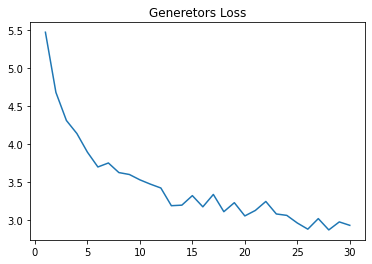

In [48]:
# show Generetors Loss
my_plot(np.linspace(1, n_epochs, n_epochs).astype(int), loss_vals,"Generetors Loss")

# **Submission**

In [55]:
#Directory
! mkdir images

In [50]:
!pwd

/content


In [51]:
def reverse_normalize(image, mean_=0.5, std_=0.5):
    if torch.is_tensor(image):
        image = image.detach().numpy()
    un_normalized_img = image * std_ + mean_
    un_normalized_img = un_normalized_img * 255
    return np.uint8(un_normalized_img)

In [56]:
!ls

DL--BIU---2021	images	monet_jpg  photo_jpg  sample_data


In [57]:
Generator_photo_to_monet.eval() # test mode

mean_=0.5 
std_=0.5

#Get data loader for final transformation / submission
submit_dataloader  = DataLoader(
    ImageDataset(root, 
                 transforms_=transforms_, unaligned=False,mode='all'),
    batch_size=1, # 1
    shuffle=False,
    num_workers=n_cpu # 3
)
print(len(submit_dataloader))
dataiter = iter(submit_dataloader)
#Loop through each picture
for image_idx in range(0, len(submit_dataloader)):
    #Get base picture
    fixed_X = next(dataiter)
    real_Photo = fixed_X['B'].type(Tensor) # B : photo
    #Identify correct device
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    fake_Monet_monet = Generator_photo_to_monet(real_Photo)
    image1_numpy = fake_Monet_monet.detach().cpu().numpy()
    image1_numpy= np.squeeze(image1_numpy, axis=0)
    image1_numpy = image1_numpy.transpose(1, 2, 0)
    image1_numpy = reverse_normalize(image1_numpy, mean_, std_)
    image1_numpy = np.uint8(image1_numpy)
    image_i = Image.fromarray(image1_numpy)
    print(image1_numpy.shape)
    #Save picture
    image_i.save("images/" + str(image_idx) + ".jpg")

    
    

Streaming output truncated to the last 5000 lines.
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 

In [58]:
import shutil
shutil.make_archive("zip_images", 'zip', "images")

'/content/zip_images.zip'

# Step 15. Check Result!

In [59]:
temp_imgs = next(iter(val_dataloader))

In [61]:
Generator_monet_to_photo.eval() # test mode 
Generator_photo_to_monet.eval() # test mode
print(temp_imgs['A'].shape)
print(temp_imgs['B'].shape)


torch.Size([5, 3, 256, 256])
torch.Size([5, 3, 256, 256])


In [62]:
temp_real_A = temp_imgs['A'].type(Tensor) # A : monet
temp_fake_B = Generator_monet_to_photo(temp_real_A).detach()
temp_real_B = temp_imgs['B'].type(Tensor) # B : photo
temp_fake_A = Generator_photo_to_monet(temp_real_B).detach()

In [63]:
temp_real_A = make_grid(temp_real_A, nrow=5, normalize=True)
temp_real_B = make_grid(temp_real_B, nrow=5, normalize=True)
temp_fake_A = make_grid(temp_fake_A, nrow=5, normalize=True)
temp_fake_B = make_grid(temp_fake_B, nrow=5, normalize=True)

In [70]:
temp_image_grid = torch.cat((temp_real_A,temp_fake_B, temp_real_B,temp_fake_A ), 1)
print(temp_image_grid.shape)
temp_image_grid.cpu().permute(1,2,0).shape

torch.Size([3, 1040, 1292])


torch.Size([1040, 1292, 3])

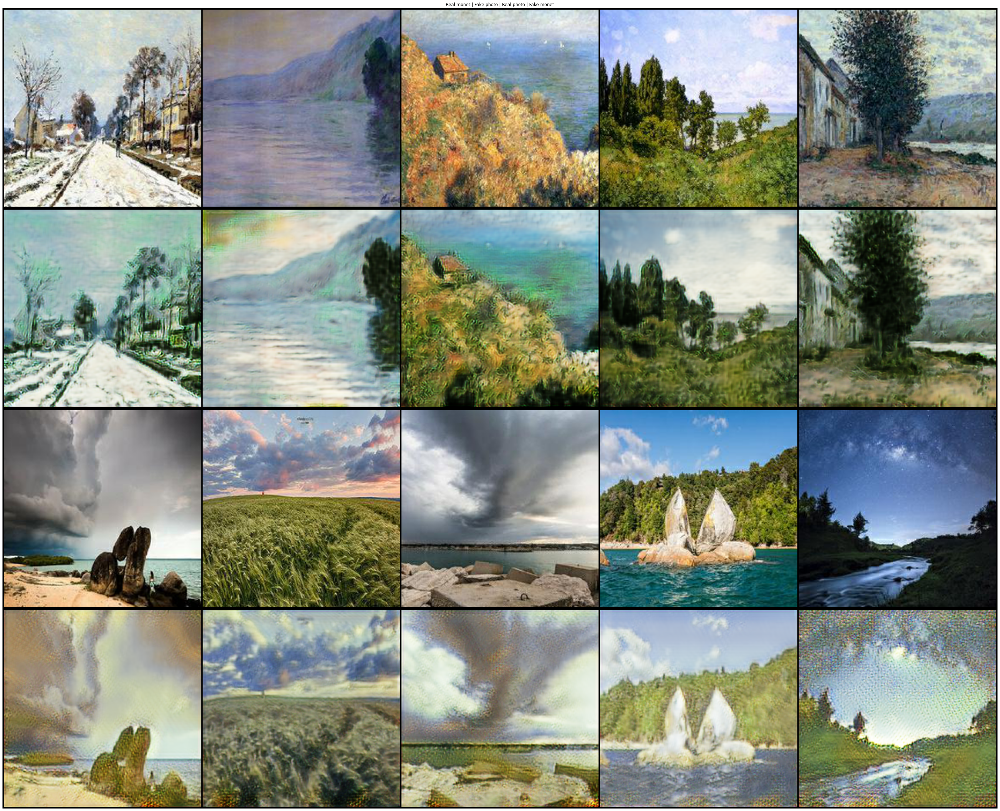

In [71]:
plt.figure(figsize=[50, 50])
plt.imshow(temp_image_grid.cpu().permute(1,2,0))
plt.title('Real monet | Fake photo | Real photo | Fake monet')
plt.axis('off');